# Graph Tutorial - Part 3: Community Detection

**Goal:** Reveal structure hidden in the connectome by grouping neurons into communities.

**Methods covered:**
- Modularity-based: Louvain, Leiden
- Stochastic Block Model (SBM)
- Spectral Clustering: ASE, LSE

---
# PART 0: SETUP

## 0.1 Imports

In [1]:
# ▶ RUN THIS CELL: Import required libraries
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter, defaultdict
import time
import warnings
warnings.filterwarnings('ignore')

# Set random seed for reproducibility
np.random.seed(42)

# Figure settings for presentation-quality plots
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 150
plt.rcParams['font.size'] = 16

# Import shared utilities from plots.py
from plots import (
    visualize_graph, 
    plot_adjacency_matrix, 
    plot_communities_comparison,
    nx_to_gt,  # NetworkX -> graph-tool conversion
    IPYSIGMA_AVAILABLE
)

# Check for graph-tool
try:
    import graph_tool.all as gt
    GRAPH_TOOL_AVAILABLE = True
    print('✓ graph-tool available')
    if gt.openmp_enabled():
        print(f'  OpenMP enabled: {gt.openmp_get_num_threads()} threads')
except ImportError:
    GRAPH_TOOL_AVAILABLE = False
    print('⚠️ graph-tool not available (SBM will be skipped)')

# Check for graspologic (includes Leiden, ASE, LSE)
try:
    from graspologic.embed import AdjacencySpectralEmbed, LaplacianSpectralEmbed
    from graspologic.partition import leiden
    GRASPOLOGIC_AVAILABLE = True
    print('✓ graspologic available (Leiden, ASE, LSE)')
except ImportError:
    GRASPOLOGIC_AVAILABLE = False
    print('⚠️ graspologic not available (Leiden, ASE, LSE will be skipped)')

print('✓ Imports successful!')

✓ graph-tool available
  OpenMP enabled: 16 threads
✓ graspologic available (Leiden, ASE, LSE)
✓ Imports successful!


## 0.2 Load Connectome Data

We load synapse data from the **FAFB** (Full Adult Fly Brain) dataset, specifically the **central complex** region.

In [2]:
# ▶ RUN THIS CELL: Load connectome data
import os
import pandas as pd

# Configuration
DATASET = 'fafb_783'
REGION = 'central_complex'

# Try local path first, then GCS
LOCAL_PATH = f'data/{DATASET}_{REGION}_synapses.feather'
GCS_PATH = f'gs://sjcabs_2025_data/fafb/{REGION}/{DATASET}_{REGION}_synapses.feather'
META_PATH = f'gs://sjcabs_2025_data/fafb/{REGION}/{DATASET}_{REGION}_meta.feather'

if os.path.exists(LOCAL_PATH):
    print(f'Loading from local: {LOCAL_PATH}')
    synapses_df = pd.read_feather(LOCAL_PATH)
else:
    print(f'Loading from GCS: {GCS_PATH}')
    import gcsfs
    gcs = gcsfs.GCSFileSystem(token='google_default')
    import pyarrow.feather as feather
    with gcs.open(GCS_PATH.replace('gs://', ''), 'rb') as f:
        synapses_df = feather.read_feather(f)
    with gcs.open(META_PATH.replace('gs://', ''), 'rb') as f:
        meta_df = feather.read_feather(f)

print(f'✓ Loaded {len(synapses_df):,} synapses')
print(f'  Columns: {list(synapses_df.columns)}')
synapses_df.head()


Loading from GCS: gs://sjcabs_2025_data/fafb/central_complex/fafb_783_central_complex_synapses.feather
✓ Loaded 1,820,042 synapses
  Columns: ['id', 'connector_id', 'x', 'y', 'z', 'confidence', 'syn_top_nt', 'syn_top_p', 'gaba', 'acetylcholine', 'glutamate', 'octopamine', 'serotonin', 'dopamine', 'prepost', 'pre', 'post', 'neuropil', 'pre_label', 'post_label', 'side']


,id,connector_id,x,y,z,confidence,syn_top_nt,syn_top_p,gaba,acetylcholine,...,octopamine,serotonin,dopamine,prepost,pre,post,neuropil,pre_label,post_label,side
0,37903271,8415165437,435587,268526,197920,142,dopamine,0.49,0.02,0.31,...,0.00,0.14,0.49,0,720575940602430944,720575940621854563,IPS,axon,axon,right
1,38453376,8415165437,440918,258788,197240,132,acetylcholine,0.87,0.03,0.87,...,0.01,0.02,0.07,0,720575940602430944,720575940631537735,IPS,axon,axon,right
2,133622988,4758879023,430782,250449,104440,137,acetylcholine,0.97,0.00,0.97,...,0.02,0.00,0.01,0,720575940602430944,720575940624323475,LAL,axon,unknown,right
3,171205160,8415165437,442883,253256,200480,63,acetylcholine,0.98,0.00,0.98,...,0.00,0.00,0.01,0,720575940602430944,720575940631537735,IPS,axon,axon,right
4,40090700,5005274937,560716,178635,129400,157,acetylcholine,0.97,0.00,0.97,...,0.00,0.00,0.03,0,720575940602747360,720575940613326250,FB,axon,dendrite,None


In [3]:
meta_df

,fafb_783_id,region,side,hemilineage,nerve,flow,super_class,cell_class,cell_sub_class,cell_type,neurotransmitter_predicted,neurotransmitter_score,cell_function,cell_function_detailed,body_part_sensory,body_part_effector,status
0,720575940624306494,central_brain,right,DL1_dorsal,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,FB1E,glutamate,0.6320337084025082,None,None,None,None,None
1,720575940611904997,central_brain,right,DL1_dorsal,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,FB1D,glutamate,0.6744326496570434,None,None,None,None,None
2,720575940606483657,central_brain,right,DL1_dorsal,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,FB1D,glutamate,0.7353487175904272,None,None,None,None,None
3,720575940621768385,central_brain,right,DM6__prim,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,FB1C,dopamine,0.5400922790216068,None,None,None,None,None
4,720575940623199070,central_brain,right,DM6__prim,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,FB1C,dopamine,0.4473239691522386,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2852,720575940628073235,central_brain,right,LALv1_dorsal,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,SA1,glutamate,0.5820494343656971,None,None,None,None,None
2853,720575940610070626,central_brain,right,LALv1_dorsal,None,intrinsic,central_brain_intrinsic,central_complex_input_neuron,FB_tangential,SA3,glutamate,0.6715286488413313,None,None,None,None,None
2854,720575940619489088,central_brain,left,DM4_CX_d1,None,intrinsic,central_brain_intrinsic,central_complex_intrinsic_neuron,None,PFGs,serotonin,0.5145923450219761,None,None,None,None,None
2855,720575940620365812,central_brain,right,DM2_CX_p,None,intrinsic,central_brain_intrinsic,central_complex_intrinsic_neuron,vDelta,vDeltaM,acetylcholine,0.5920266229020595,None,None,None,None,None


In [4]:
# ▶ RUN THIS CELL: Build NetworkX graph from synapse data

# Create directed graph from synapse data
# Each row is a synapse: pre -> post
G_connectome = nx.DiGraph()

# Add edges (multiple synapses between same neurons become edge weight)
edge_counts = synapses_df.groupby(['pre', 'post']).size().reset_index(name='weight')
for _, row in edge_counts.iterrows():
    G_connectome.add_edge(row['pre'], row['post'], weight=row['weight'])

print(f'✓ Built connectome graph')
print(f'  Nodes: {G_connectome.number_of_nodes():,}')
print(f'  Edges: {G_connectome.number_of_edges():,}')
print(f'  Density: {nx.density(G_connectome):.4f}')

# Store density for later use
CONNECTOME_DENSITY = nx.density(G_connectome)


✓ Built connectome graph
  Nodes: 10,572
  Edges: 340,036
  Density: 0.0030


In [5]:
# Add node attributes from graph structure
nx.set_node_attributes(G_connectome, dict(G_connectome.degree()), 'degree')
nx.set_node_attributes(G_connectome, dict(G_connectome.in_degree()), 'in_degree')
nx.set_node_attributes(G_connectome, dict(G_connectome.out_degree()), 'out_degree')

# Add node attributes from metadata
# Columns to include: side, hemilineage, cell_class, cell_type, neurotransmitter_prediction
META_COLUMNS = ['side', 'hemilineage', 'cell_class', 'cell_type', 'neurotransmitter_predicted']
ID_COLUMN = f'{DATASET}_id'  # e.g., 'fafb_783_id'

# Create mapping from neuron ID to metadata
meta_dict = meta_df.set_index(ID_COLUMN)[META_COLUMNS].to_dict('index')

# Add each metadata column as node attribute
n_labeled = 0
for col in META_COLUMNS:
    attr_dict = {}
    for node in G_connectome.nodes():
        if node in meta_dict:
            attr_dict[node] = meta_dict[node].get(col)
            if col == 'cell_type' and meta_dict[node].get(col) is not None:
                n_labeled += 1
        else:
            attr_dict[node] = None
    nx.set_node_attributes(G_connectome, attr_dict, col)

print(f'✓ Full connectome node attributes set:')
print(f'  Structural: degree, in_degree, out_degree')
print(f'  Metadata: {", ".join(META_COLUMNS)}')
print(f'  Neurons with cell_type labels: {n_labeled:,} / {G_connectome.number_of_nodes():,} ({n_labeled/G_connectome.number_of_nodes()*100:.1f}%)')

✓ Full connectome node attributes set:
  Structural: degree, in_degree, out_degree
  Metadata: side, hemilineage, cell_class, cell_type, neurotransmitter_predicted
  Neurons with cell_type labels: 2,772 / 10,572 (26.2%)


In [6]:
# ═══════════════════════════════════════════════════════════════════════════════
# Create subgraph with only labeled neurons (has cell_type metadata)
# This will be used for all subsequent community detection analysis
# ═══════════════════════════════════════════════════════════════════════════════

# Keep full connectome for reference
G_connectome_full = G_connectome.copy()
print(f'Full connectome: {G_connectome_full.number_of_nodes():,} neurons, {G_connectome_full.number_of_edges():,} edges')

# Filter to neurons with cell_type labels
cell_types = nx.get_node_attributes(G_connectome, 'cell_type')
labeled_nodes = [n for n in G_connectome.nodes() if cell_types.get(n) is not None]

# Create subgraph (preserves all node/edge attributes)
G_connectome = G_connectome.subgraph(labeled_nodes).copy()

# Recalculate degree attributes for the subgraph
nx.set_node_attributes(G_connectome, dict(G_connectome.degree()), 'degree')
nx.set_node_attributes(G_connectome, dict(G_connectome.in_degree()), 'in_degree')
nx.set_node_attributes(G_connectome, dict(G_connectome.out_degree()), 'out_degree')

print(f'\n✓ Created labeled-only connectome subgraph')
print(f'  Nodes: {G_connectome.number_of_nodes():,} (neurons with cell_type labels)')
print(f'  Edges: {G_connectome.number_of_edges():,}')
print(f'  Density: {nx.density(G_connectome):.4f}')

# Count unique cell types
unique_cell_types = set(cell_types[n] for n in G_connectome.nodes())
print(f'  Unique cell types: {len(unique_cell_types)}')

Full connectome: 10,572 neurons, 340,036 edges

✓ Created labeled-only connectome subgraph
  Nodes: 2,772 (neurons with cell_type labels)
  Edges: 262,544
  Density: 0.0342
  Unique cell types: 227


## 0.3 Generate Example Graph

We create a **hierarchical planted partition** graph for demonstrating community detection methods:
- 4 communities × 10 nodes = 40 nodes
- Hierarchical structure: two "super-communities" (A,B) and (C,D)
- Dense feedforward connections: A→C and B→D

This small graph allows us to visualize algorithm behavior before applying to the real connectome.

In [7]:
# ═══════════════════════════════════════════════════════════════════════════════
# Generate hierarchical planted partition graph
# ═══════════════════════════════════════════════════════════════════════════════

# Block-wise probability matrix
# Rows/Cols: [A, B, C, D]
P_blocks = np.array([
    #    A     B     C     D
    [0.15, 0.05, 0.40, 0.05],  # A: sparse internal, DENSE to C
    [0.05, 0.15, 0.05, 0.40],  # B: sparse internal, DENSE to D
    [0.05, 0.05, 0.15, 0.05],  # C: sparse internal
    [0.05, 0.05, 0.05, 0.15],  # D: sparse internal
])

# Generate network
np.random.seed(42)
cluster_size = 10
n_nodes_example = 4 * cluster_size

# Create node-to-cluster mapping
node_to_cluster = {}
clusters = {'A': [], 'B': [], 'C': [], 'D': []}
cluster_names = ['A', 'B', 'C', 'D']

for i, cluster_name in enumerate(cluster_names):
    start = i * cluster_size
    end = start + cluster_size
    clusters[cluster_name] = list(range(start, end))
    for node in range(start, end):
        node_to_cluster[node] = i

# Generate adjacency matrix
A_example = np.zeros((n_nodes_example, n_nodes_example))
for i in range(n_nodes_example):
    for j in range(n_nodes_example):
        if i != j:
            block_i = node_to_cluster[i]
            block_j = node_to_cluster[j]
            prob = P_blocks[block_i, block_j]
            if np.random.rand() < prob:
                A_example[i, j] = np.random.uniform(0.5, 1.5)

# Create NetworkX graph
G_example = nx.DiGraph()
for i in range(n_nodes_example):
    for j in range(n_nodes_example):
        if A_example[i, j] > 0:
            G_example.add_edge(i, j, weight=A_example[i, j])

# Add cluster attribute
for node in G_example.nodes():
    G_example.nodes[node]['cluster'] = node_to_cluster[node]

# Ground truth communities
ground_truth = [set(nodes) for nodes in clusters.values()]

print(f'✓ Example graph: {G_example.number_of_nodes()} nodes, {G_example.number_of_edges()} edges')
print(f'  4 communities: A, B, C, D (10 nodes each)')
print(f'  Structure: A→C and B→D (feedforward pathways)')

✓ Example graph: 40 nodes, 179 edges
  4 communities: A, B, C, D (10 nodes each)
  Structure: A→C and B→D (feedforward pathways)


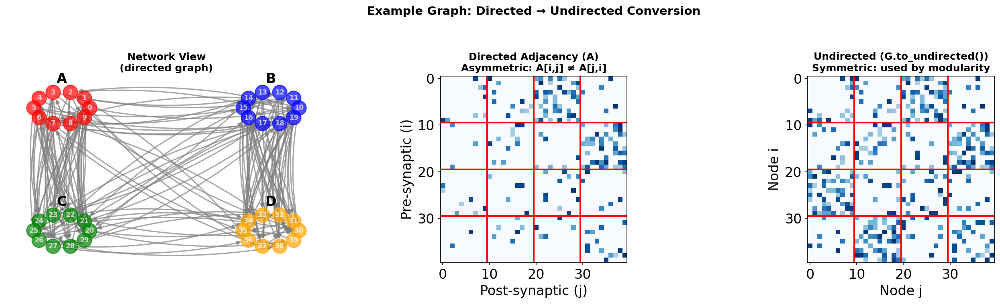

💡 to_undirected() symmetrizes by taking ONE edge weight when reciprocal edges exist
   (not A + A.T which would sum weights)
✓ Saved: imgs/fig_example_graph.png


In [8]:
# [FIGURE] Visualize example graph: Network + Directed vs Undirected Adjacency
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Left: Network visualization
ax = axes[0]
cluster_centers = {
    'A': np.array([-1.5, 1.5]),   # Top-left
    'B': np.array([1.5, 1.5]),    # Top-right
    'C': np.array([-1.5, -1.5]),  # Bottom-left
    'D': np.array([1.5, -1.5])    # Bottom-right
}

pos_example = {}
for cluster_name, nodes in clusters.items():
    center = cluster_centers[cluster_name]
    n_cluster = len(nodes)
    angles = np.linspace(0, 2*np.pi, n_cluster, endpoint=False)
    for i, node in enumerate(nodes):
        pos_example[node] = (center[0] + 0.4 * np.cos(angles[i]), 
                             center[1] + 0.4 * np.sin(angles[i]))

color_palette = ['red', 'blue', 'green', 'orange']
node_colors = [color_palette[node_to_cluster[n]] for n in G_example.nodes()]

nx.draw(G_example, pos_example, ax=ax,
       node_color=node_colors, node_size=300, with_labels=True, font_size=8,
       font_weight='bold', font_color='white', edge_color='gray', alpha=0.7,
       arrows=True, arrowsize=10, width=1.5, connectionstyle='arc3,rad=0.1')

# Add cluster labels
for cluster_name, center in cluster_centers.items():
    ax.text(center[0], center[1] + 0.7, cluster_name, fontsize=16, 
            fontweight='bold', ha='center', va='center')

ax.set_title('Network View\n(directed graph)', fontsize=12, fontweight='bold')

# Middle: Directed adjacency matrix
ax = axes[1]
sorted_order = []
for cluster_name in ['A', 'B', 'C', 'D']:
    sorted_order.extend(clusters[cluster_name])
A_sorted = A_example[np.ix_(sorted_order, sorted_order)]

im = ax.imshow(A_sorted, cmap='Blues', aspect='equal')
for boundary in [10, 20, 30]:
    ax.axhline(y=boundary-0.5, color='red', linewidth=2)
    ax.axvline(x=boundary-0.5, color='red', linewidth=2)

ax.set_title('Directed Adjacency (A)\nAsymmetric: A[i,j] ≠ A[j,i]', fontsize=12, fontweight='bold')
ax.set_xlabel('Post-synaptic (j)')
ax.set_ylabel('Pre-synaptic (i)')

# Right: Undirected adjacency matrix (what modularity methods use)
ax = axes[2]
G_example_und = G_example.to_undirected()
A_example_und = nx.adjacency_matrix(G_example_und, nodelist=sorted_order).toarray().astype(float)

im = ax.imshow(A_example_und, cmap='Blues', aspect='equal')
for boundary in [10, 20, 30]:
    ax.axhline(y=boundary-0.5, color='red', linewidth=2)
    ax.axvline(x=boundary-0.5, color='red', linewidth=2)

ax.set_title('Undirected (G.to_undirected())\nSymmetric: used by modularity', fontsize=12, fontweight='bold')
ax.set_xlabel('Node j')
ax.set_ylabel('Node i')

plt.suptitle('Example Graph: Directed → Undirected Conversion', fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.savefig('imgs/fig_example_graph.png', dpi=150, bbox_inches='tight')
plt.show()

print('💡 to_undirected() symmetrizes by taking ONE edge weight when reciprocal edges exist')
print('   (not A + A.T which would sum weights)')
print('✓ Saved: imgs/fig_example_graph.png')

# PART 1: WHY COMMUNITY DETECTION?

**Goal:** Reveal structure homogeneity and heterogeneity. 

Community detection transforms a messy "hairball" into organized modules.

## 1.1 Motivation: Unsorted vs Sorted Adjacency Matrix

The same network can look completely different depending on node ordering.

Let's compare our example graph before and after sorting by community membership.

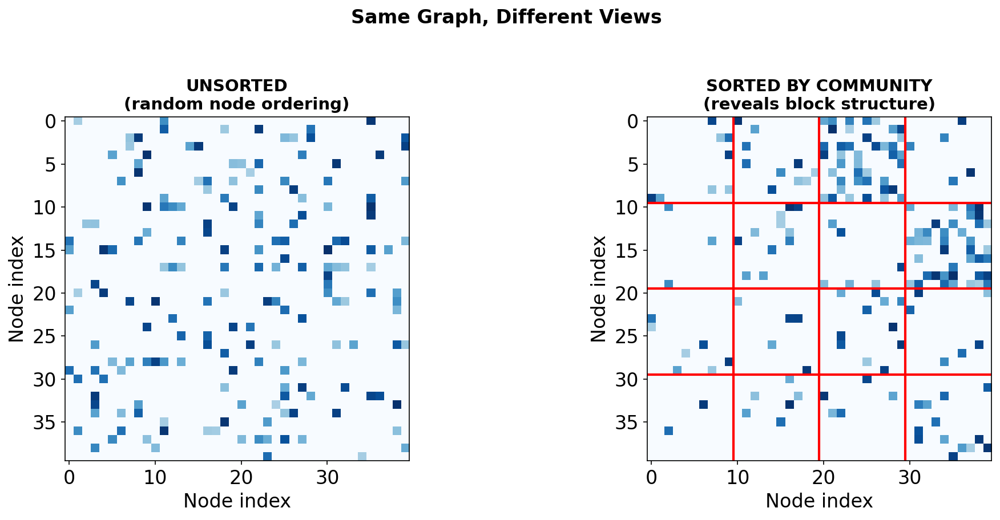

💡 KEY INSIGHT: Community detection finds the node ordering that reveals structure!


In [9]:
# [FIGURE] Unsorted vs Sorted Adjacency Matrix
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Left: Original (random) ordering
ax = axes[0]
random_order = np.random.permutation(n_nodes_example)
A_random = A_example[np.ix_(random_order, random_order)]
ax.imshow(A_random, cmap='Blues', aspect='equal')
ax.set_title('UNSORTED\n(random node ordering)', fontsize=14, fontweight='bold')
ax.set_xlabel('Node index')
ax.set_ylabel('Node index')

# Right: Sorted by ground truth community
ax = axes[1]
sorted_order = []
for cluster_name in ['A', 'B', 'C', 'D']:
    sorted_order.extend(clusters[cluster_name])
A_sorted = A_example[np.ix_(sorted_order, sorted_order)]
ax.imshow(A_sorted, cmap='Blues', aspect='equal')
# Add community boundaries
for boundary in [10, 20, 30]:
    ax.axhline(y=boundary-0.5, color='red', linewidth=2)
    ax.axvline(x=boundary-0.5, color='red', linewidth=2)
ax.set_title('SORTED BY COMMUNITY\n(reveals block structure)', fontsize=14, fontweight='bold')
ax.set_xlabel('Node index')
ax.set_ylabel('Node index')

plt.suptitle('Same Graph, Different Views', fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

print('💡 KEY INSIGHT: Community detection finds the node ordering that reveals structure!')

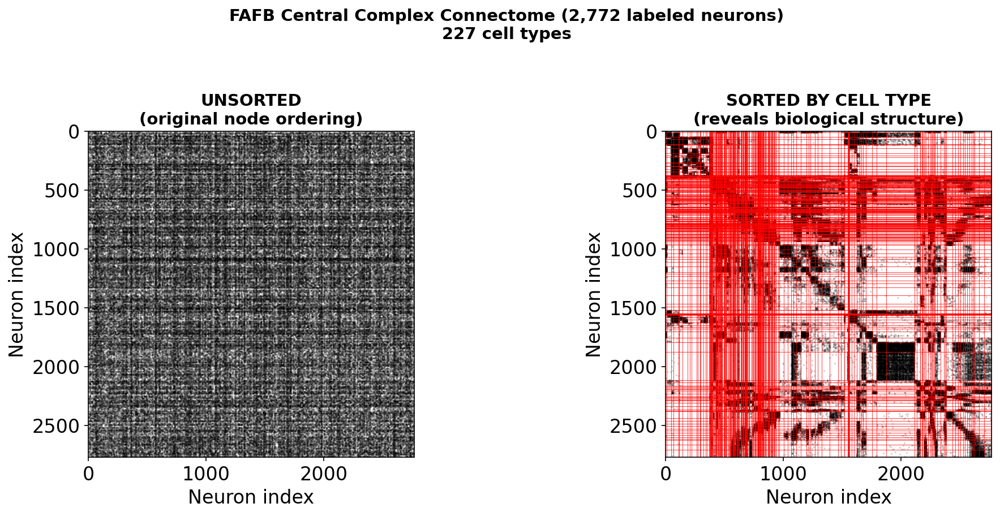

💡 KEY INSIGHT: Known cell types create block structure in the connectome!
   227 unique cell types, 226 boundaries
✓ Saved: imgs/fig_connectome_sorted_celltype.png


In [10]:
# [FIGURE] Real Connectome: Unsorted vs Sorted by Cell Type
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Get node list and adjacency matrix
connectome_nodes_temp = list(G_connectome.nodes())
A_temp = nx.adjacency_matrix(G_connectome, nodelist=connectome_nodes_temp).toarray().astype(float)

# Get cell types
cell_types = nx.get_node_attributes(G_connectome, 'cell_type')

# Left: Original ordering (by node ID)
ax = axes[0]
rows, cols = np.nonzero(A_temp)
ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
ax.set_xlim(-0.5, len(connectome_nodes_temp)-0.5)
ax.set_ylim(len(connectome_nodes_temp)-0.5, -0.5)
ax.set_title('UNSORTED\n(original node ordering)', fontsize=14, fontweight='bold')
ax.set_xlabel('Neuron index')
ax.set_ylabel('Neuron index')
ax.set_aspect('equal')

# Right: Sorted by cell type
ax = axes[1]

# Sort nodes by cell type
nodes_with_type = [(n, cell_types[n]) for n in connectome_nodes_temp]
sorted_nodes = sorted(nodes_with_type, key=lambda x: (x[1], x[0]))
sorted_order = [n for n, _ in sorted_nodes]

# Create index mapping
node_idx_map = {n: i for i, n in enumerate(connectome_nodes_temp)}
order = [node_idx_map[n] for n in sorted_order]
A_sorted_ct = A_temp[np.ix_(order, order)]

rows, cols = np.nonzero(A_sorted_ct)
ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
ax.set_xlim(-0.5, len(connectome_nodes_temp)-0.5)
ax.set_ylim(len(connectome_nodes_temp)-0.5, -0.5)

# Add boundaries between cell types
sorted_types = [t for _, t in sorted_nodes]
boundaries = []
prev_type = sorted_types[0]
for i, t in enumerate(sorted_types):
    if t != prev_type:
        boundaries.append(i)
        prev_type = t

for b in boundaries:
    ax.axhline(y=b-0.5, color='red', linewidth=0.5, alpha=0.7)
    ax.axvline(x=b-0.5, color='red', linewidth=0.5, alpha=0.7)

ax.set_title('SORTED BY CELL TYPE\n(reveals biological structure)', fontsize=14, fontweight='bold')
ax.set_xlabel('Neuron index')
ax.set_ylabel('Neuron index')
ax.set_aspect('equal')

# Count unique cell types
unique_types = set(sorted_types)
plt.suptitle(f'FAFB Central Complex Connectome ({len(connectome_nodes_temp):,} labeled neurons)\n{len(unique_types)} cell types', 
             fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.savefig('imgs/fig_connectome_sorted_celltype.png', dpi=150, bbox_inches='tight')
plt.show()

print(f'💡 KEY INSIGHT: Known cell types create block structure in the connectome!')
print(f'   {len(unique_types)} unique cell types, {len(boundaries)} boundaries')
print('✓ Saved: imgs/fig_connectome_sorted_celltype.png')

---
# PART 2: MODULARITY-BASED METHODS (Louvain / Leiden)

## 2.1 Modularity Equation

**Modularity** measures partition quality: how many more edges exist within communities than expected by chance?

$$Q = \frac{1}{2m} \sum_{ij} \left[ A_{ij} - \frac{k_i k_j}{2m} \right] \delta(c_i, c_j)$$

Where:
- $A_{ij}$ = edge weight between nodes i and j
- $k_i, k_j$ = degrees of nodes i and j  
- $m$ = total edge weight
- $\delta(c_i, c_j) = 1$ if i and j are in the same community

**Interpretation:**
- $Q \approx 0$: Random (no structure)
- $Q < 0$: Disassortative (anti-community)

In [11]:
# ═══════════════════════════════════════════════════════════════════════════════
# HYPERPARAMETERS: Example Graph
# ═══════════════════════════════════════════════════════════════════════════════
RANDOM_SEED = 42

# Louvain / Leiden
LOUVAIN_RESOLUTION = 1.0  # Higher = more communities
LEIDEN_RESOLUTION = 1.0

# SBM (graph-tool)
SBM_DEG_CORR = True
SBM_NESTED = True
SBM_MCMC_SWEEPS = 10

# Spectral Embedding
SPECTRAL_N_COMPONENTS = None  # Auto-detect via elbow
SPECTRAL_N_ELBOWS = 2
SPECTRAL_N_CLUSTERS = None    # Auto from Louvain
SPECTRAL_KMEANS_INIT = 10
LSE_FORM = 'DAD'  # DAD works better than R-DAD for this connectome

print('✓ Hyperparameters set')

✓ Hyperparameters set


In [12]:
# ═══════════════════════════════════════════════════════════════════════════════
# METHOD 1: Louvain & Leiden
# ═══════════════════════════════════════════════════════════════════════════════
# NOTE: Both methods require UNDIRECTED graphs for modularity optimization.
# We convert directed → undirected using G.to_undirected(), which:
#   - Makes edges bidirectional
#   - For reciprocal edges (i→j and j→i), keeps ONE weight (not sum)
# ═══════════════════════════════════════════════════════════════════════════════

def run_louvain(G, resolution=LOUVAIN_RESOLUTION, seed=RANDOM_SEED, verbose=True):
    """
    Run Louvain community detection (NetworkX implementation).
    
    Parameters
    ----------
    G : nx.Graph or nx.DiGraph
        Input graph. If directed, converted to undirected via G.to_undirected().
    resolution : float
        Resolution parameter. Higher = more communities.
    seed : int
        Random seed for reproducibility.
    
    Returns
    -------
    communities : list of sets
    modularity : float
    info : dict
    """
    # Convert to undirected (modularity is defined for undirected graphs)
    if G.is_directed():
        G_undirected = G.to_undirected()
        converted = True
    else:
        G_undirected = G
        converted = False
    
    start = time.time()
    communities = list(nx.community.louvain_communities(
        G_undirected, seed=seed, resolution=resolution))
    Q = nx.community.modularity(G_undirected, communities)
    elapsed = time.time() - start
    
    if verbose:
        print(f'LOUVAIN (resolution={resolution})')
        if converted:
            print(f'  [Converted to undirected: {G_undirected.number_of_edges():,} edges]')
        print(f'  Communities: {len(communities)}, Q={Q:.3f}, Time: {elapsed:.1f}s')
        sizes = sorted([len(c) for c in communities], reverse=True)
        print(f'  Sizes: {sizes[:5]}{"..." if len(sizes) > 5 else ""}')
    
    return communities, Q, {'time': elapsed, 'resolution': resolution}


def run_leiden(G, resolution=LEIDEN_RESOLUTION, seed=RANDOM_SEED, verbose=True):
    """
    Run Leiden community detection (graspologic implementation).
    
    Parameters
    ----------
    G : nx.Graph or nx.DiGraph
        Input graph. If directed, converted to undirected via G.to_undirected().
    resolution : float
        Resolution parameter. Higher = more communities.
    seed : int
        Random seed for reproducibility.
    
    Returns
    -------
    communities : list of sets
    modularity : float
    info : dict
    """
    if not GRASPOLOGIC_AVAILABLE:
        raise ImportError("graspologic not available")
    
    # Convert to undirected (modularity is defined for undirected graphs)
    if G.is_directed():
        G_undirected = G.to_undirected()
        converted = True
    else:
        G_undirected = G
        converted = False
    
    node_list = list(G.nodes())
    
    start = time.time()
    
    # Pass NetworkX graph directly (not adjacency matrix) to preserve node IDs
    # and handle weighted edges correctly
    result = leiden(G_undirected, resolution=resolution, random_seed=seed)
    
    # result is a dict: {node_id: community_label}
    # Convert to list of sets
    n_comms = max(result.values()) + 1
    communities = [set() for _ in range(n_comms)]
    for node, label in result.items():
        communities[label].add(node)
    communities = [c for c in communities if len(c) > 0]
    
    # Handle isolate nodes (not in the partition) - assign each to its own community
    nodes_in_partition = set(result.keys())
    isolates = set(node_list) - nodes_in_partition
    if isolates:
        for node in isolates:
            communities.append({node})
    
    # Check for degenerate case (all singletons)
    if len(communities) == len(node_list):
        elapsed = time.time() - start
        if verbose:
            print(f'LEIDEN (resolution={resolution})')
            if converted:
                print(f'  [Converted to undirected: {G_undirected.number_of_edges():,} edges]')
            print(f'  ⚠️ Degenerate: all {len(communities)} nodes in separate communities')
            print(f'  Skipping modularity calculation (invalid partition)')
        return communities, np.nan, {'time': elapsed, 'resolution': resolution, 'degenerate': True}
    
    Q = nx.community.modularity(G_undirected, communities)
    elapsed = time.time() - start
    
    if verbose:
        print(f'LEIDEN (resolution={resolution})')
        if converted:
            print(f'  [Converted to undirected: {G_undirected.number_of_edges():,} edges]')
        print(f'  Communities: {len(communities)}, Q={Q:.3f}, Time: {elapsed:.1f}s')
        sizes = sorted([len(c) for c in communities], reverse=True)
        print(f'  Sizes: {sizes[:5]}{"..." if len(sizes) > 5 else ""}')
        if isolates:
            print(f'  Note: {len(isolates)} isolate nodes added to separate communities')
    
    return communities, Q, {'time': elapsed, 'resolution': resolution}


print('✓ Louvain and Leiden functions defined')
print('  Note: Both convert directed graphs to undirected for modularity optimization')

✓ Louvain and Leiden functions defined
  Note: Both convert directed graphs to undirected for modularity optimization


## 2.2 Resolution Parameter

The resolution parameter $\gamma$ modifies the modularity equation:

$$Q = \frac{1}{2m} \sum_{ij} \left[ A_{ij} - \gamma \cdot \frac{k_i k_j}{2m} \right] \delta(c_i, c_j)$$

| Term | Meaning |
|------|---------|
| $A_{ij}$ | Actual edge weight between nodes i and j |
| $k_i, k_j$ | Degree of node i and j (number of edges connected to each) |
| $m$ | Total number of edges in the graph (or sum of edge weights) |
| $\frac{k_i k_j}{2m}$ | **Expected** edges between i and j under null model (configuration model) |
| $\gamma$ | Resolution parameter — scales the null expectation |
| $\delta(c_i, c_j)$ | 1 if i,j in same community, else 0 |

**What γ does:**

The term $A_{ij} - \gamma \cdot \frac{k_i k_j}{2m}$ compares **observed** vs **expected** edges:

- **γ = 1** (default): Standard modularity. "Are there more edges than expected by chance?"
- **γ < 1**: Underweight null expectation → small excess looks significant → **fewer, larger communities**
- **γ > 1**: Overweight null expectation → need bigger excess → **more, smaller communities**

**Intuition:** Think of γ as a "skepticism dial":
- Low γ = easily impressed, groups things together
- High γ = skeptical, requires strong evidence to group

This is why **resolution scanning** (trying multiple γ values) reveals hierarchical structure at different scales.

## 2.3 Run Louvain/Leiden on Connectome

Now let's apply modularity-based methods to the real connectome.

In [13]:
# Initialize results DataFrame to accumulate results from each method
import pandas as pd

results_df = pd.DataFrame(columns=['Method', 'Communities', 'Modularity', 'Largest', 'Smallest', 'Time'])

# Prepare connectome adjacency matrix (used by spectral methods)
connectome_nodes = list(G_connectome.nodes())
A_connectome = nx.adjacency_matrix(G_connectome, nodelist=connectome_nodes).toarray().astype(float)

print(f'Connectome: {G_connectome.number_of_nodes():,} neurons, {G_connectome.number_of_edges():,} connections')
print('✓ Results DataFrame initialized')

Connectome: 2,772 neurons, 262,544 connections
✓ Results DataFrame initialized


In [14]:
# ═══════════════════════════════════════════════════════════════════════════════
# Run Louvain on connectome
# ═══════════════════════════════════════════════════════════════════════════════
print('LOUVAIN: FAFB Central Complex Connectome')
print('=' * 60)

louvain_comms, louvain_Q, louvain_info = run_louvain(G_connectome, verbose=True)

# Add to results DataFrame
sizes = sorted([len(c) for c in louvain_comms], reverse=True)
results_df.loc[len(results_df)] = ['Louvain', len(louvain_comms), louvain_Q,
                                    sizes[0], sizes[-1], louvain_info['time']]

# Store communities as node attribute
node_to_comm = {}
for comm_id, comm in enumerate(louvain_comms):
    for node in comm:
        node_to_comm[node] = comm_id
nx.set_node_attributes(G_connectome, node_to_comm, 'community_louvain')

print(f'\n✓ Community labels stored as node attribute: community_louvain')

LOUVAIN: FAFB Central Complex Connectome
LOUVAIN (resolution=1.0)
  [Converted to undirected: 211,987 edges]
  Communities: 9, Q=0.554, Time: 1.1s
  Sizes: [753, 479, 441, 438, 348]...

✓ Community labels stored as node attribute: community_louvain


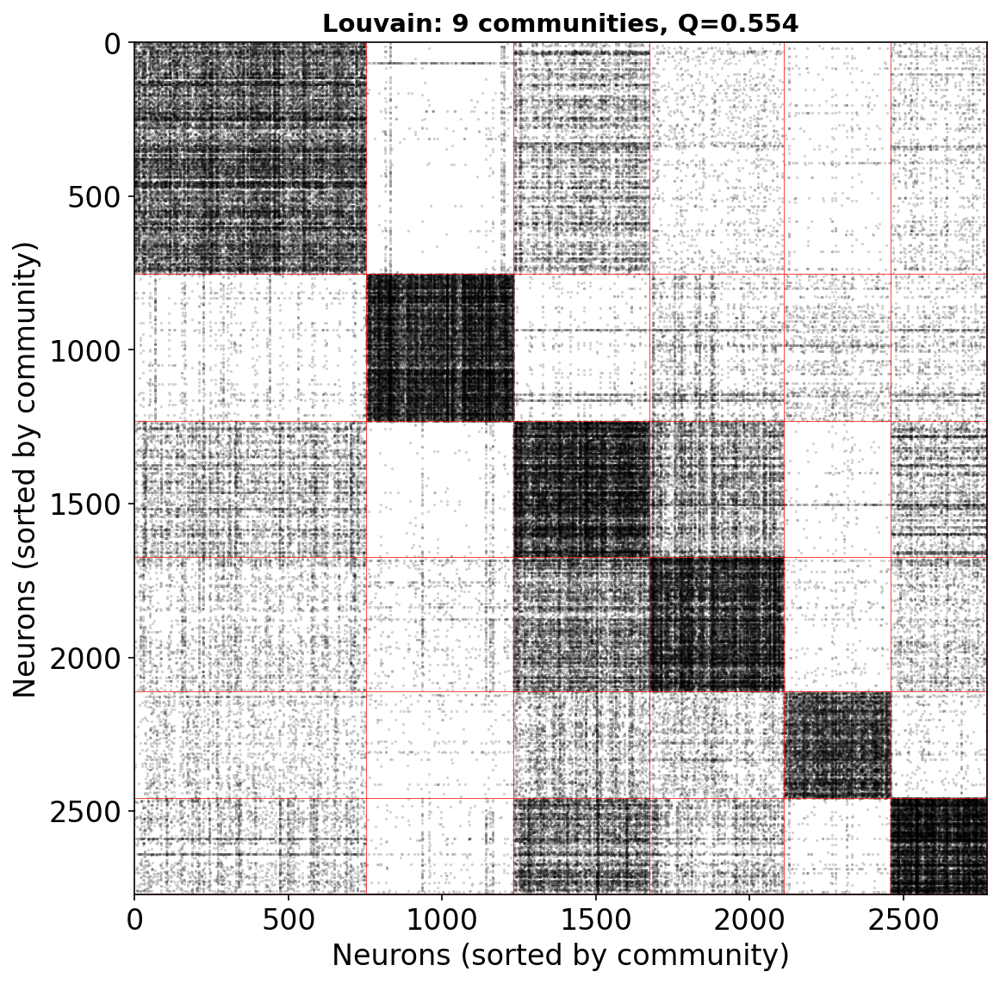

✓ Saved: imgs/fig_connectome_louvain.png


In [15]:
# [FIGURE] Louvain: Adjacency matrix sorted by community
fig, ax = plt.subplots(1, 1, figsize=(8, 8))

# Sort nodes by community (largest communities first)
sorted_communities = sorted(enumerate(louvain_comms), key=lambda x: -len(x[1]))
ordered_nodes = []
for _, comm in sorted_communities:
    ordered_nodes.extend(sorted(list(comm)))

# Create reordered adjacency matrix
node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
order = [node_idx_map[n] for n in ordered_nodes]
A_reordered = A_connectome[np.ix_(order, order)]

# Plot as sparse matrix
rows, cols = np.nonzero(A_reordered)
ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
ax.set_ylim(len(ordered_nodes)-0.5, -0.5)

# Add community boundaries
cumsum = 0
for i, (_, comm) in enumerate(sorted_communities):
    cumsum += len(comm)
    ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
    ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)

ax.set_title(f'Louvain: {len(louvain_comms)} communities, Q={louvain_Q:.3f}', fontsize=14, fontweight='bold')
ax.set_xlabel('Neurons (sorted by community)')
ax.set_ylabel('Neurons (sorted by community)')
ax.set_aspect('equal')

plt.tight_layout()
plt.savefig('imgs/fig_connectome_louvain.png', dpi=150, bbox_inches='tight')
plt.show()
print('✓ Saved: imgs/fig_connectome_louvain.png')

In [16]:
# ═══════════════════════════════════════════════════════════════════════════════
# Run Leiden on connectome
# ═══════════════════════════════════════════════════════════════════════════════
if GRASPOLOGIC_AVAILABLE:
    print('LEIDEN: FAFB Central Complex Connectome')
    print('=' * 60)

    leiden_comms, leiden_Q, leiden_info = run_leiden(G_connectome, verbose=True)

    # Only add to results if not degenerate
    if not leiden_info.get('degenerate', False):
        sizes = sorted([len(c) for c in leiden_comms], reverse=True)
        results_df.loc[len(results_df)] = ['Leiden', len(leiden_comms), leiden_Q,
                                            sizes[0], sizes[-1], leiden_info['time']]

        # Store communities as node attribute
        node_to_comm = {}
        for comm_id, comm in enumerate(leiden_comms):
            for node in comm:
                node_to_comm[node] = comm_id
        nx.set_node_attributes(G_connectome, node_to_comm, 'community_leiden')

        print(f'\n✓ Community labels stored as node attribute: community_leiden')
    else:
        print(f'\n⚠️ Leiden produced degenerate partition - skipping')
        print(f'   Try lower resolution (e.g., 0.01) for dense networks')
        leiden_comms = None  # Mark as failed
else:
    print('⚠️ graspologic not available - skipping Leiden')
    leiden_comms = None

LEIDEN: FAFB Central Complex Connectome
LEIDEN (resolution=1.0)
  [Converted to undirected: 211,987 edges]
  Communities: 9, Q=0.551, Time: 0.3s
  Sizes: [699, 486, 480, 448, 342]...
  Note: 3 isolate nodes added to separate communities

✓ Community labels stored as node attribute: community_leiden


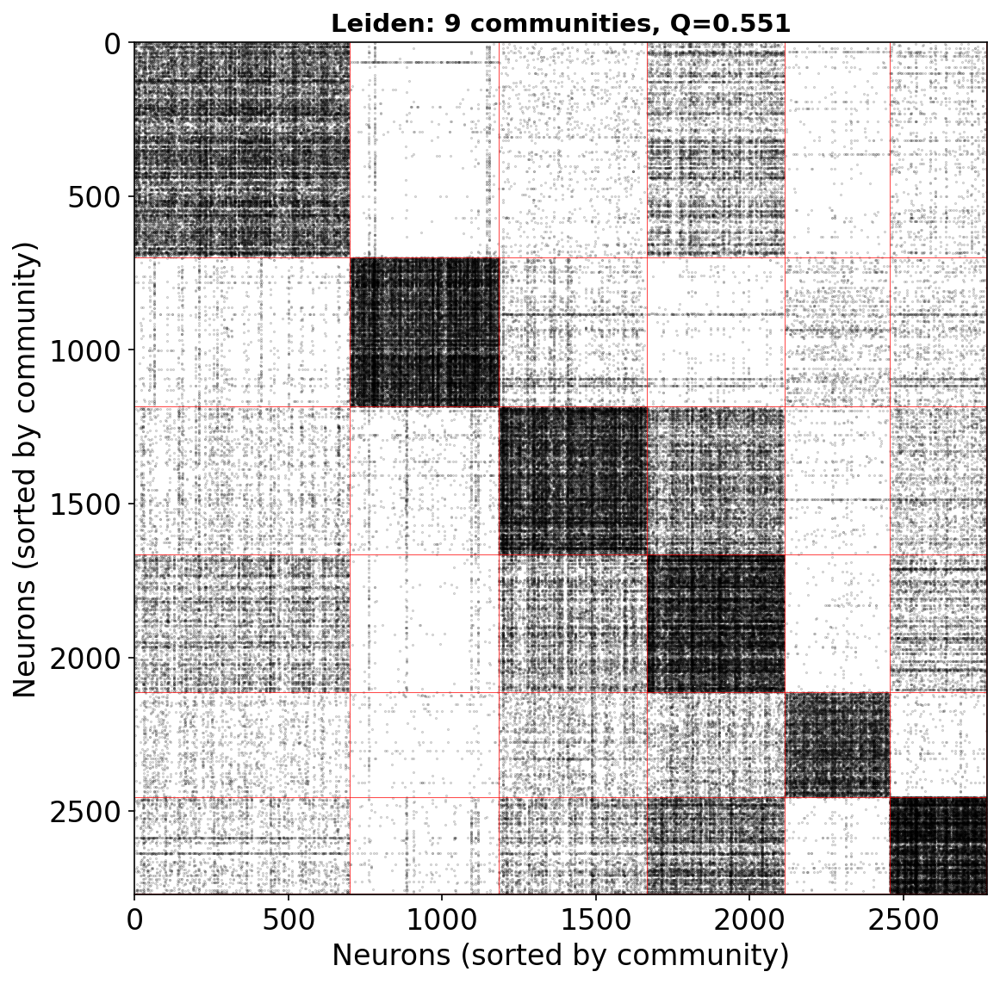

✓ Saved: imgs/fig_connectome_leiden.png


In [17]:
# [FIGURE] Leiden: Adjacency matrix sorted by community
if leiden_comms is not None:
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    # Sort nodes by community (largest communities first)
    sorted_communities = sorted(enumerate(leiden_comms), key=lambda x: -len(x[1]))
    ordered_nodes = []
    for _, comm in sorted_communities:
        ordered_nodes.extend(sorted(list(comm)))

    # Create reordered adjacency matrix
    node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
    order = [node_idx_map[n] for n in ordered_nodes]
    A_reordered = A_connectome[np.ix_(order, order)]

    # Plot as sparse matrix
    rows, cols = np.nonzero(A_reordered)
    ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
    ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
    ax.set_ylim(len(ordered_nodes)-0.5, -0.5)

    # Add community boundaries
    cumsum = 0
    for i, (_, comm) in enumerate(sorted_communities):
        cumsum += len(comm)
        ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
        ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)

    ax.set_title(f'Leiden: {len(leiden_comms)} communities, Q={leiden_Q:.3f}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Neurons (sorted by community)')
    ax.set_ylabel('Neurons (sorted by community)')
    ax.set_aspect('equal')

    plt.tight_layout()
    plt.savefig('imgs/fig_connectome_leiden.png', dpi=150, bbox_inches='tight')
    plt.show()
    print('✓ Saved: imgs/fig_connectome_leiden.png')
else:
    print('⚠️ Leiden skipped (degenerate partition)')

## 2.4 Caveat: Assortative vs Disassortative Structure

**Modularity has a fundamental limitation:** It assumes communities are **assortative** (more edges within than between).

- **Assortative:** Dense diagonal blocks (typical "communities")
- **Disassortative:** Dense off-diagonal blocks (feedforward, core-periphery)

⚠️ **Modularity-based methods will fail on disassortative networks!**

CONCEPT: Assortative vs Disassortative Community Structure

ASORTATIVE Network:
  Internal edges: 49 (94%)
  External edges: 3 (6%)

DISASORTATIVE Network:
  Internal edges: 6 (9%)
  External edges: 59 (91%)


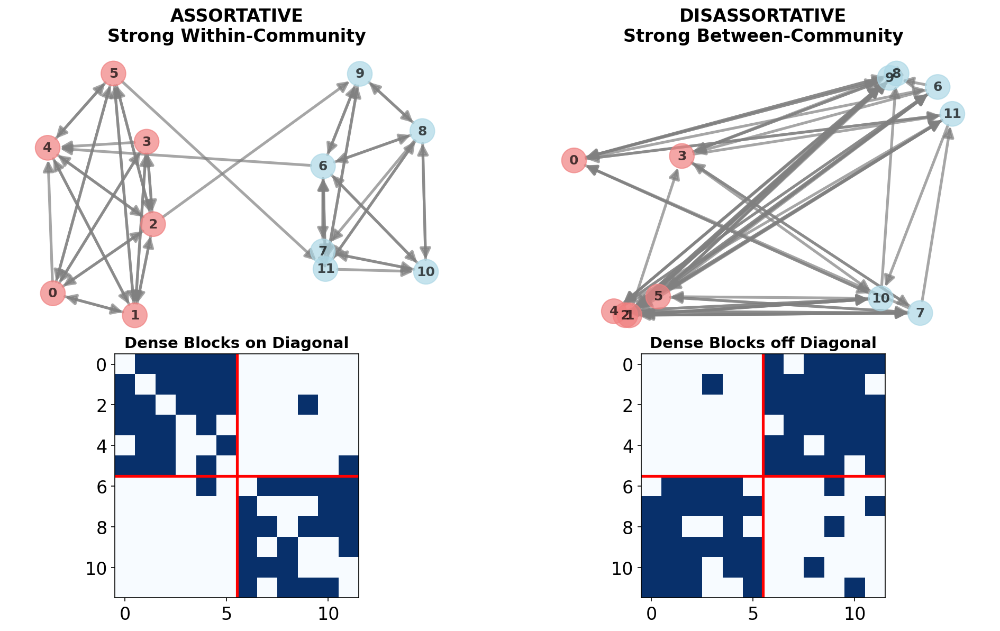


💡 KEY INSIGHT:
   ASSORTATIVE: Modularity works well (high Q)
   DISASSORTATIVE: Modularity fails (low/negative Q)
   → Use SBM for disassortative structure!


In [ ]:
# [FIGURE] Illustration: Assortative vs Disassortative Communities
print('CONCEPT: Assortative vs Disassortative Community Structure')
print('=' * 60)

# Create two simple example networks
np.random.seed(123)

# ASSORTATIVE: High within-community, low between-community connections
P_assortative = np.array([
    [0.8, 0.1],  # Community 0: 80% internal, 10% to other
    [0.1, 0.8],  # Community 1: 10% from other, 80% internal
])

# DISASSORTATIVE: Low within-community, high between-community connections  
P_disassortative = np.array([
    [0.2, 0.7],  # Community 0: 20% internal, 70% to other
    [0.7, 0.2],  # Community 1: 70% from other, 20% internal
])

def generate_community_network(P_matrix, comm_size=6, seed=123):
    """Generate a directed network from community probability matrix"""
    np.random.seed(seed)
    n_comm = len(P_matrix)
    n_nodes = n_comm * comm_size
    
    A = np.zeros((n_nodes, n_nodes))
    node_to_comm = {}
    
    for i in range(n_nodes):
        node_to_comm[i] = i // comm_size
    
    for i in range(n_nodes):
        for j in range(n_nodes):
            if i != j:
                comm_i = node_to_comm[i]
                comm_j = node_to_comm[j]
                prob = P_matrix[comm_i, comm_j]
                if np.random.rand() < prob:
                    A[i, j] = 1
    
    return A, node_to_comm

# Generate networks
A_assort, node_to_comm_assort = generate_community_network(P_assortative, comm_size=6)
A_disassort, node_to_comm_disassort = generate_community_network(P_disassortative, comm_size=6)

# Create NetworkX graphs
G_assort = nx.DiGraph(A_assort)
G_disassort = nx.DiGraph(A_disassort)

# Count internal vs external edges
def count_edge_types(A, node_to_comm):
    internal = external = 0
    for i in range(len(A)):
        for j in range(len(A)):
            if A[i, j] > 0:
                if node_to_comm[i] == node_to_comm[j]:
                    internal += 1
                else:
                    external += 1
    return internal, external

internal_assort, external_assort = count_edge_types(A_assort, node_to_comm_assort)
internal_disassort, external_disassort = count_edge_types(A_disassort, node_to_comm_disassort)

print(f'\nASORTATIVE Network:')
print(f'  Internal edges: {internal_assort} ({internal_assort/(internal_assort+external_assort)*100:.0f}%)')
print(f'  External edges: {external_assort} ({external_assort/(internal_assort+external_assort)*100:.0f}%)')

print(f'\nDISASORTATIVE Network:')
print(f'  Internal edges: {internal_disassort} ({internal_disassort/(internal_disassort+external_disassort)*100:.0f}%)')
print(f'  External edges: {external_disassort} ({external_disassort/(internal_disassort+external_disassort)*100:.0f}%)')

# Visualize
fig = plt.figure(figsize=(16, 9))
gs = fig.add_gridspec(2, 2, height_ratios=[1.2, 1], hspace=0.05, wspace=0.15)

ax_graph_assort = fig.add_subplot(gs[0, 0])
ax_graph_disassort = fig.add_subplot(gs[0, 1])
ax_matrix_assort = fig.add_subplot(gs[1, 0])
ax_matrix_disassort = fig.add_subplot(gs[1, 1])

colors = ['lightcoral', 'lightblue']

def community_layout(G, node_to_comm):
    pos = {}
    comm_positions = {0: (-1, 0), 1: (1, 0)}
    for node in G.nodes():
        comm = node_to_comm[node]
        center = comm_positions[comm]
        angle = np.random.uniform(0, 2*np.pi)
        pos[node] = (center[0] + 0.4*np.cos(angle), center[1] + 0.4*np.sin(angle))
    return pos

pos_assort = community_layout(G_assort, node_to_comm_assort)
pos_disassort = community_layout(G_disassort, node_to_comm_disassort)

# ASSORTATIVE Graph
node_colors_assort = [colors[node_to_comm_assort[n]] for n in G_assort.nodes()]
nx.draw(G_assort, pos_assort, ax=ax_graph_assort, node_color=node_colors_assort,
       node_size=500, with_labels=True, font_size=12, font_weight='bold',
       edge_color='gray', alpha=0.7, arrows=True, arrowsize=20, width=2.5)
ax_graph_assort.set_title('ASSORTATIVE\nStrong Within-Community', fontsize=16, fontweight='bold')

# DISASSORTATIVE Graph
node_colors_disassort = [colors[node_to_comm_disassort[n]] for n in G_disassort.nodes()]
nx.draw(G_disassort, pos_disassort, ax=ax_graph_disassort, node_color=node_colors_disassort,
       node_size=500, with_labels=True, font_size=12, font_weight='bold',
       edge_color='gray', alpha=0.7, arrows=True, arrowsize=20, width=2.5)
ax_graph_disassort.set_title('DISASSORTATIVE\nStrong Between-Community', fontsize=16, fontweight='bold')
dd
# ASSORTATIVE Matrix
ax_matrix_assort.imshow(A_assort, cmap='Blues', aspect='equal')
ax_matrix_assort.axhline(y=5.5, color='red', linewidth=2.5)
ax_matrix_assort.axvline(x=5.5, color='red', linewidth=2.5)
ax_matrix_assort.set_title('Dense Blocks on Diagonal', fontsize=14, fontweight='bold')

# DISASSORTATIVE Matrix
ax_matrix_disassort.imshow(A_disassort, cmap='Blues', aspect='equal')
ax_matrix_disassort.axhline(y=5.5, color='red', linewidth=2.5)
ax_matrix_disassort.axvline(x=5.5, color='red', linewidth=2.5)
ax_matrix_disassort.set_title('Dense Blocks off Diagonal', fontsize=14, fontweight='bold')

plt.savefig('imgs/fig_assortative_vs_disassortative.png', dpi=150, bbox_inches='tight')
plt.show()

print('\n💡 KEY INSIGHT:')
print('   ASSORTATIVE: Modularity works well (high Q)')
print('   DISASSORTATIVE: Modularity fails (low/negative Q)')
print('   → Use SBM for disassortative structure!')
print('=' * 60)

---
# PART 3: STOCHASTIC BLOCK MODEL (SBM)

The SBM is a **generative model** that explicitly models block structure:

$$P(A_{ij} = 1) = B_{k\ell} \quad \text{where } k = \text{block}(i), \ell = \text{block}(j)$$

**Advantages over modularity:**
- Can detect both assortative AND disassortative structure
- Principled model selection (no resolution parameter needed)
- Hierarchical (nested) variants automatically find the right number of communities

## 3.1 Degree-Corrected SBM

Real networks have **degree heterogeneity** (hubs and peripheral nodes within the same community).

The degree-corrected SBM adds node-specific degree propensities:

$$P(A_{ij}) = \theta_i \theta_j B_{k\ell}$$

where $\theta_i$ captures node $i$'s degree tendency.

**Recommendation:** Always use `deg_corr=True` for real networks.

## 3.2 Nested SBM

The **nested SBM** builds a hierarchy of block models:
- No need to specify number of communities (auto-determined via MDL principle)
- Reveals multi-scale structure

We use `graph-tool`'s `minimize_nested_blockmodel_dl()` for efficient inference.

In [22]:
# ═══════════════════════════════════════════════════════════════════════════════
# METHOD 2: Stochastic Block Model (graph-tool)
# ═══════════════════════════════════════════════════════════════════════════════

def run_sbm(G, nested=SBM_NESTED, deg_corr=SBM_DEG_CORR, 
            mcmc_sweeps=SBM_MCMC_SWEEPS, verbose=True):
    """
    Run Stochastic Block Model using graph-tool.
    
    Parameters
    ----------
    G : nx.DiGraph
        Input graph
    nested : bool
        Use nested (hierarchical) SBM. Auto-determines number of communities.
    deg_corr : bool
        Use degree-corrected model. Recommended for real networks.
    mcmc_sweeps : int
        Number of MCMC refinement sweeps.
    
    Returns
    -------
    communities : list of sets
    modularity : float
    info : dict (includes 'state', 'entropy', 'n_levels' for nested)
    """
    if not GRAPH_TOOL_AVAILABLE:
        raise ImportError("graph-tool not available")
    
    G_undirected = G.to_undirected() if G.is_directed() else G
    
    start = time.time()
    
    # Convert to graph-tool using shared utility
    G_gt, node_map = nx_to_gt(G)
    node_list = list(G.nodes())
    
    sbm_type = 'Nested' if nested else 'Flat'
    if verbose:
        print(f'SBM ({sbm_type}, deg_corr={deg_corr})')
    
    # Fit SBM
    if nested:
        state = gt.minimize_nested_blockmodel_dl(
            G_gt, state_args=dict(deg_corr=deg_corr))
        levels = state.get_levels()
        block_property = levels[0].get_blocks()
    else:
        state = gt.minimize_blockmodel_dl(
            G_gt, state_args=dict(deg_corr=deg_corr))
        block_property = state.get_blocks()
    
    entropy = state.entropy()
    
    # Optional MCMC refinement
    if mcmc_sweeps > 0:
        for _ in range(mcmc_sweeps):
            state.multiflip_mcmc_sweep(niter=1)
        if nested:
            levels = state.get_levels()
            block_property = levels[0].get_blocks()
        else:
            block_property = state.get_blocks()
    
    # Extract communities
    sbm_labels = [block_property[v] for v in range(G_gt.num_vertices())]
    n_blocks = max(sbm_labels) + 1
    communities = [set() for _ in range(n_blocks)]
    for idx, block_id in enumerate(sbm_labels):
        communities[block_id].add(node_list[idx])
    communities = [c for c in communities if len(c) > 0]
    
    Q = nx.community.modularity(G_undirected, communities)
    elapsed = time.time() - start
    
    info = {'time': elapsed, 'entropy': entropy, 'state': state, 
            'nested': nested, 'deg_corr': deg_corr}
    if nested:
        info['n_levels'] = len(state.get_levels())
    
    if verbose:
        print(f'  Communities: {len(communities)}, Q={Q:.3f}, Time: {elapsed:.1f}s')
        sizes = sorted([len(c) for c in communities], reverse=True)
        print(f'  Sizes: {sizes[:5]}{"..." if len(sizes) > 5 else ""}')
        print(f'  Description length: {entropy:.1f}')
        if nested:
            print(f'  Hierarchy levels: {info["n_levels"]}')
    
    return communities, Q, info


print('✓ SBM function defined (uses nx_to_gt from plots.py)')

✓ SBM function defined (uses nx_to_gt from plots.py)


## 3.3 Run SBM on Connectome

In [23]:
# ═══════════════════════════════════════════════════════════════════════════════
# Run all SBM variants on connectome
# ═══════════════════════════════════════════════════════════════════════════════
if GRAPH_TOOL_AVAILABLE:
    print('SBM Variants: FAFB Central Complex Connectome')
    print('=' * 60)
    
    # Store all SBM results
    sbm_results = {}
    
    # 1. Plain SBM (no degree correction, no nesting)
    print('\n[1/3] Plain SBM')
    print('-' * 40)
    sbm_comms_plain, sbm_Q_plain, sbm_info_plain = run_sbm(
        G_connectome, nested=False, deg_corr=False, verbose=True)
    sbm_results['SBM'] = {
        'comms': sbm_comms_plain, 'Q': sbm_Q_plain, 'info': sbm_info_plain}
    
    # 2. Degree-Corrected SBM (no nesting)
    print('\n[2/3] Degree-Corrected SBM')
    print('-' * 40)
    sbm_comms_dc, sbm_Q_dc, sbm_info_dc = run_sbm(
        G_connectome, nested=False, deg_corr=True, verbose=True)
    sbm_results['DC-SBM'] = {
        'comms': sbm_comms_dc, 'Q': sbm_Q_dc, 'info': sbm_info_dc}
    
    # 3. Nested Degree-Corrected SBM
    print('\n[3/3] Nested Degree-Corrected SBM')
    print('-' * 40)
    sbm_comms_nested, sbm_Q_nested, sbm_info_nested = run_sbm(
        G_connectome, nested=True, deg_corr=True, verbose=True)
    sbm_results['Nested DC-SBM'] = {
        'comms': sbm_comms_nested, 'Q': sbm_Q_nested, 'info': sbm_info_nested}
    
    # Add all to results DataFrame
    for name, res in sbm_results.items():
        sizes = sorted([len(c) for c in res['comms']], reverse=True)
        results_df.loc[len(results_df)] = [name, len(res['comms']), res['Q'],
                                            sizes[0], sizes[-1], res['info']['time']]
    
    # Store the nested version as the default node attribute
    node_to_comm = {}
    for comm_id, comm in enumerate(sbm_comms_nested):
        for node in comm:
            node_to_comm[node] = comm_id
    nx.set_node_attributes(G_connectome, node_to_comm, 'community_sbm')
    
    # Print comparison summary
    print('\n' + '=' * 60)
    print('SBM COMPARISON SUMMARY')
    print('=' * 60)
    print(f"{'Method':<20} {'Communities':>12} {'Modularity':>12} {'Time (s)':>10}")
    print('-' * 60)
    for name, res in sbm_results.items():
        n_levels = res['info'].get('n_levels', 1)
        level_str = f" ({n_levels} levels)" if n_levels > 1 else ""
        print(f"{name + level_str:<20} {len(res['comms']):>12} {res['Q']:>12.4f} {res['info']['time']:>10.2f}")
    
    print('\n✓ Community labels stored as node attribute: community_sbm (Nested DC-SBM)')
else:
    print('⚠️ graph-tool not available - skipping SBM')

SBM Variants: FAFB Central Complex Connectome

[1/3] Plain SBM
----------------------------------------
SBM (Flat, deg_corr=False)
  Communities: 118, Q=0.103, Time: 15.3s
  Sizes: [98, 75, 73, 65, 61]...
  Description length: 687699.5

[2/3] Degree-Corrected SBM
----------------------------------------
SBM (Flat, deg_corr=True)
  Communities: 122, Q=0.123, Time: 13.3s
  Sizes: [85, 77, 67, 60, 60]...
  Description length: 682154.8

[3/3] Nested Degree-Corrected SBM
----------------------------------------
SBM (Nested, deg_corr=True)
  Communities: 301, Q=0.074, Time: 49.1s
  Sizes: [34, 30, 30, 30, 28]...
  Description length: 651892.2
  Hierarchy levels: 13

SBM COMPARISON SUMMARY
Method                Communities   Modularity   Time (s)
------------------------------------------------------------
SBM                           118       0.1025      15.30
DC-SBM                        122       0.1233      13.32
Nested DC-SBM (13 levels)          301       0.0740      49.14

✓ Communi

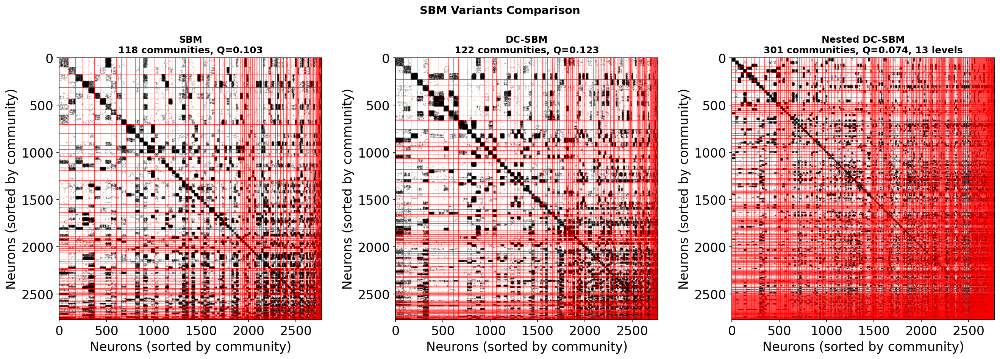

✓ Saved: imgs/fig_sbm_comparison.png


In [24]:
# [FIGURE] SBM Comparison: Adjacency matrices sorted by community
if GRAPH_TOOL_AVAILABLE and 'sbm_results' in dir():
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    for ax, (name, res) in zip(axes, sbm_results.items()):
        comms = res['comms']
        Q = res['Q']
        
        # Sort nodes by community (largest communities first)
        sorted_communities = sorted(enumerate(comms), key=lambda x: -len(x[1]))
        ordered_nodes = []
        for _, comm in sorted_communities:
            ordered_nodes.extend(sorted(list(comm)))
        
        # Create reordered adjacency matrix
        node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
        order = [node_idx_map[n] for n in ordered_nodes]
        A_reordered = A_connectome[np.ix_(order, order)]
        
        # Plot as sparse matrix
        rows, cols = np.nonzero(A_reordered)
        ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
        ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
        ax.set_ylim(len(ordered_nodes)-0.5, -0.5)
        
        # Add community boundaries
        cumsum = 0
        for i, (_, comm) in enumerate(sorted_communities):
            cumsum += len(comm)
            ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
            ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
        
        n_levels = res['info'].get('n_levels', 1)
        level_str = f", {n_levels} levels" if n_levels > 1 else ""
        ax.set_title(f'{name}\n{len(comms)} communities, Q={Q:.3f}{level_str}', 
                     fontsize=12, fontweight='bold')
        ax.set_xlabel('Neurons (sorted by community)')
        ax.set_ylabel('Neurons (sorted by community)')
        ax.set_aspect('equal')
    
    plt.suptitle('SBM Variants Comparison', fontsize=14, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.savefig('imgs/fig_sbm_comparison.png', dpi=150, bbox_inches='tight')
    plt.show()
    print('✓ Saved: imgs/fig_sbm_comparison.png')
else:
    print('⚠️ SBM skipped (graph-tool not available)')

---
# PART 4: SPECTRAL CLUSTERING

**Two-step approach:**
1. **Embed:** $A \xrightarrow{\text{SVD}} \hat{X}$ (n × d matrix)
2. **Cluster:** $\hat{X} \xrightarrow{\text{K-means / GMM}}$ labels

The embedding captures network structure in a low-dimensional space where clustering is easier.

## 4.1 ASE vs LSE

| Method | Embedding of | Reveals |
|--------|-------------|---------|
| **ASE** (Adjacency) | $A \approx X\Lambda Y^T$ | Global structure, overall connectivity patterns |
| **LSE** (Laplacian) | $L \approx X\Lambda Y^T$ | Local structure, community boundaries |

**Choosing d (embedding dimension):** Use the elbow method on singular values.

**Choosing k (number of clusters):** No automatic method. Options:
- Match to another method's k
- Use domain knowledge
- Maximize modularity of resulting clusters

In [25]:
# ═══════════════════════════════════════════════════════════════════════════════
# METHOD 3: Spectral Clustering (ASE / LSE)
# ═══════════════════════════════════════════════════════════════════════════════
from sklearn.cluster import KMeans

def run_ase(G, A=None, n_clusters=SPECTRAL_N_CLUSTERS, n_components=SPECTRAL_N_COMPONENTS, 
            n_elbows=SPECTRAL_N_ELBOWS, seed=RANDOM_SEED, verbose=True):
    """
    Run Adjacency Spectral Embedding + K-means clustering.
    
    Parameters
    ----------
    G : nx.DiGraph
        Input graph
    A : np.ndarray, optional
        Adjacency matrix (computed if not provided)
    n_clusters : int
        Number of clusters for K-means. If None, defaults to 4.
    n_components : int or None
        Embedding dimensions. None = auto via elbow method.
    
    Returns
    -------
    communities : list of sets
    modularity : float
    info : dict
    """
    if not GRASPOLOGIC_AVAILABLE:
        raise ImportError("graspologic not available")
    
    node_list = list(G.nodes())
    if A is None:
        A = nx.adjacency_matrix(G, nodelist=node_list).toarray().astype(float)
    
    G_undirected = G.to_undirected() if G.is_directed() else G
    
    start = time.time()
    
    ase = AdjacencySpectralEmbed(
        n_components=n_components,
        n_elbows=n_elbows,
        svd_seed=seed
    )
    embedding = ase.fit_transform(A)
    
    if isinstance(embedding, tuple):
        embedding = np.concatenate(embedding, axis=1)
    
    actual_dims = embedding.shape[1]
    
    # Cluster
    k = n_clusters or 4
    kmeans = KMeans(n_clusters=k, random_state=seed, n_init=SPECTRAL_KMEANS_INIT)
    labels = kmeans.fit_predict(embedding)
    
    # Convert to communities
    communities = [set() for _ in range(k)]
    for idx, label in enumerate(labels):
        communities[label].add(node_list[idx])
    communities = [c for c in communities if len(c) > 0]
    
    Q = nx.community.modularity(G_undirected, communities)
    elapsed = time.time() - start
    
    dim_str = 'auto' if n_components is None else n_components
    if verbose:
        print(f'ASE (components={dim_str} → {actual_dims}, clusters={k})')
        print(f'  Communities: {len(communities)}, Q={Q:.3f}, Time: {elapsed:.1f}s')
        print(f'  Embedding shape: {embedding.shape}')
    
    return communities, Q, {'time': elapsed, 'embedding_shape': embedding.shape,
                            'n_components_detected': actual_dims}


def run_lse(G, A=None, n_clusters=SPECTRAL_N_CLUSTERS, n_components=SPECTRAL_N_COMPONENTS,
            n_elbows=SPECTRAL_N_ELBOWS, form=LSE_FORM, seed=RANDOM_SEED, verbose=True):
    """
    Run Laplacian Spectral Embedding + K-means clustering.
    
    Parameters
    ----------
    G : nx.DiGraph
        Input graph
    A : np.ndarray, optional
        Adjacency matrix (computed if not provided)
    n_clusters : int
        Number of clusters for K-means. If None, defaults to 4.
    n_components : int or None
        Embedding dimensions. None = auto via elbow method.
    form : str
        Laplacian form: 'DAD', 'R-DAD', 'I-DAD'
    
    Returns
    -------
    communities : list of sets
    modularity : float
    info : dict
    """
    if not GRASPOLOGIC_AVAILABLE:
        raise ImportError("graspologic not available")
    
    node_list = list(G.nodes())
    if A is None:
        A = nx.adjacency_matrix(G, nodelist=node_list).toarray().astype(float)
    
    G_undirected = G.to_undirected() if G.is_directed() else G
    
    start = time.time()
    
    lse = LaplacianSpectralEmbed(
        n_components=n_components,
        n_elbows=n_elbows,
        svd_seed=seed,
        form=form
    )
    embedding = lse.fit_transform(A)
    
    if isinstance(embedding, tuple):
        embedding = np.concatenate(embedding, axis=1)
    
    actual_dims = embedding.shape[1]
    
    # Cluster
    k = n_clusters or 4
    kmeans = KMeans(n_clusters=k, random_state=seed, n_init=SPECTRAL_KMEANS_INIT)
    labels = kmeans.fit_predict(embedding)
    
    # Convert to communities
    communities = [set() for _ in range(k)]
    for idx, label in enumerate(labels):
        communities[label].add(node_list[idx])
    communities = [c for c in communities if len(c) > 0]
    
    Q = nx.community.modularity(G_undirected, communities)
    elapsed = time.time() - start
    
    dim_str = 'auto' if n_components is None else n_components
    if verbose:
        print(f'LSE (components={dim_str} → {actual_dims}, clusters={k}, form={form})')
        print(f'  Communities: {len(communities)}, Q={Q:.3f}, Time: {elapsed:.1f}s')
        print(f'  Embedding shape: {embedding.shape}')
    
    return communities, Q, {'time': elapsed, 'embedding_shape': embedding.shape,
                            'n_components_detected': actual_dims, 'form': form}


print('✓ ASE and LSE functions defined')

✓ ASE and LSE functions defined


## 4.2 Run ASE/LSE on Connectome

We use k = ??? for spectral clustering.

In [34]:
unique_types = set(v for v in cell_types.values() if v is not None)
n_clusters_spectral = len(unique_types)
print(f'Using {n_clusters_spectral} clusters for spectral methods based on cell types')

Using 227 clusters for spectral methods based on cell types


In [35]:
# ═══════════════════════════════════════════════════════════════════════════════
# Run ASE on connectome
# ═══════════════════════════════════════════════════════════════════════════════
if GRASPOLOGIC_AVAILABLE:
    print('ASE: FAFB Central Complex Connectome')
    print('=' * 60)
    
    # Use Louvain's k as target
    print(f'Using k={n_clusters_spectral} clusters (from Louvain)\n')

    ase_comms, ase_Q, ase_info = run_ase(G_connectome, A=A_connectome, 
                                          n_clusters=n_clusters_spectral, verbose=True)

    # Add to results DataFrame
    sizes = sorted([len(c) for c in ase_comms], reverse=True)
    results_df.loc[len(results_df)] = ['ASE', len(ase_comms), ase_Q,
                                        sizes[0], sizes[-1], ase_info['time']]

    # Store communities as node attribute
    node_to_comm = {}
    for comm_id, comm in enumerate(ase_comms):
        for node in comm:
            node_to_comm[node] = comm_id
    nx.set_node_attributes(G_connectome, node_to_comm, 'community_ase')

    print(f'\n✓ Community labels stored as node attribute: community_ase')
else:
    print('⚠️ graspologic not available - skipping ASE')

ASE: FAFB Central Complex Connectome
Using k=227 clusters (from Louvain)

ASE (components=auto → 16, clusters=227)
  Communities: 227, Q=0.069, Time: 1.3s
  Embedding shape: (2772, 16)

✓ Community labels stored as node attribute: community_ase


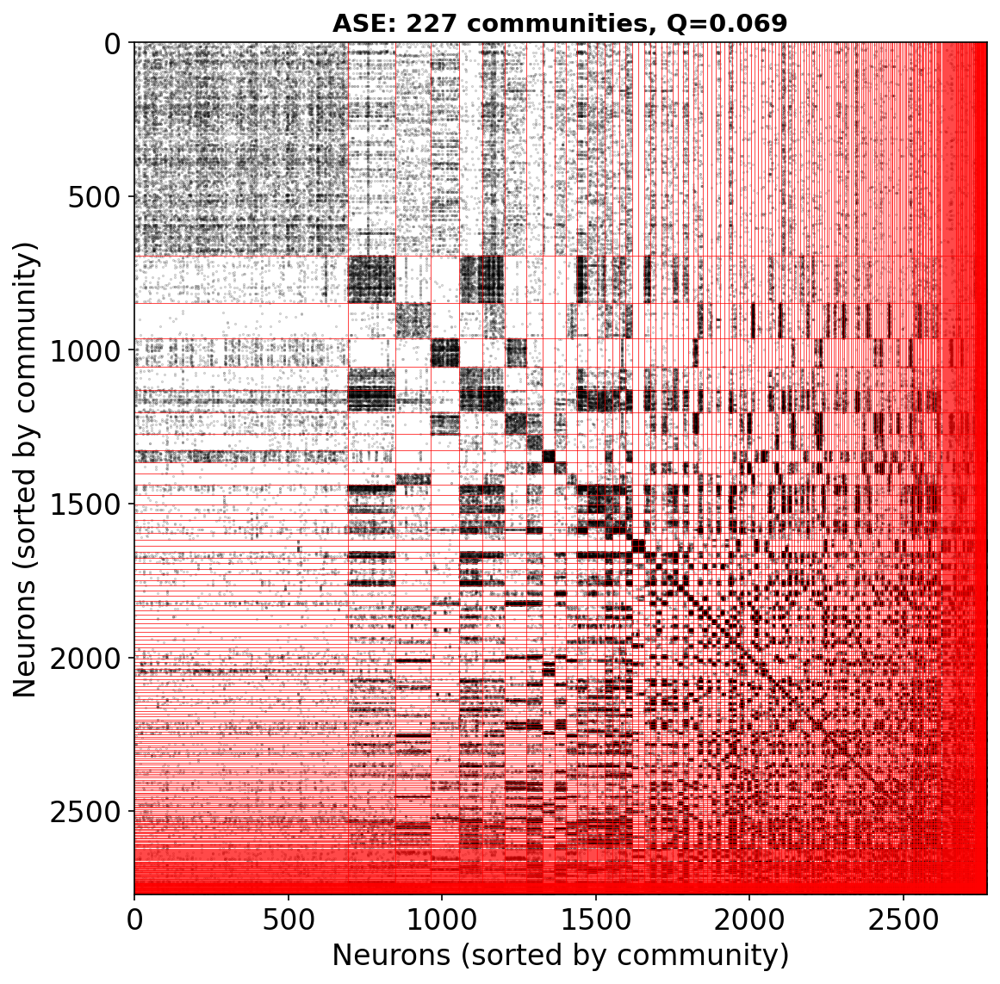

✓ Saved: imgs/fig_connectome_ase.png


In [36]:
# [FIGURE] ASE: Adjacency matrix sorted by community
if GRASPOLOGIC_AVAILABLE and 'ase_comms' in dir():
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    # Sort nodes by community (largest communities first)
    sorted_communities = sorted(enumerate(ase_comms), key=lambda x: -len(x[1]))
    ordered_nodes = []
    for _, comm in sorted_communities:
        ordered_nodes.extend(sorted(list(comm)))

    # Create reordered adjacency matrix
    node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
    order = [node_idx_map[n] for n in ordered_nodes]
    A_reordered = A_connectome[np.ix_(order, order)]

    # Plot as sparse matrix
    rows, cols = np.nonzero(A_reordered)
    ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
    ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
    ax.set_ylim(len(ordered_nodes)-0.5, -0.5)

    # Add community boundaries
    cumsum = 0
    for i, (_, comm) in enumerate(sorted_communities):
        cumsum += len(comm)
        ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
        ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)

    ax.set_title(f'ASE: {len(ase_comms)} communities, Q={ase_Q:.3f}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Neurons (sorted by community)')
    ax.set_ylabel('Neurons (sorted by community)')
    ax.set_aspect('equal')

    plt.tight_layout()
    plt.savefig('imgs/fig_connectome_ase.png', dpi=150, bbox_inches='tight')
    plt.show()
    print('✓ Saved: imgs/fig_connectome_ase.png')
else:
    print('⚠️ ASE skipped (graspologic not available)')

In [37]:
# ═══════════════════════════════════════════════════════════════════════════════
# Run LSE on connectome
# ═══════════════════════════════════════════════════════════════════════════════
if GRASPOLOGIC_AVAILABLE:
    print('LSE: FAFB Central Complex Connectome')
    print('=' * 60)

    lse_comms, lse_Q, lse_info = run_lse(G_connectome, A=A_connectome, 
                                          n_clusters=n_clusters_spectral, verbose=True)

    # Add to results DataFrame
    sizes = sorted([len(c) for c in lse_comms], reverse=True)
    results_df.loc[len(results_df)] = ['LSE', len(lse_comms), lse_Q,
                                        sizes[0], sizes[-1], lse_info['time']]

    # Store communities as node attribute
    node_to_comm = {}
    for comm_id, comm in enumerate(lse_comms):
        for node in comm:
            node_to_comm[node] = comm_id
    nx.set_node_attributes(G_connectome, node_to_comm, 'community_lse')

    print(f'\n✓ Community labels stored as node attribute: community_lse')
else:
    print('⚠️ graspologic not available - skipping LSE')

LSE: FAFB Central Complex Connectome
LSE (components=auto → 16, clusters=227, form=DAD)
  Communities: 227, Q=0.047, Time: 2.1s
  Embedding shape: (2772, 16)

✓ Community labels stored as node attribute: community_lse


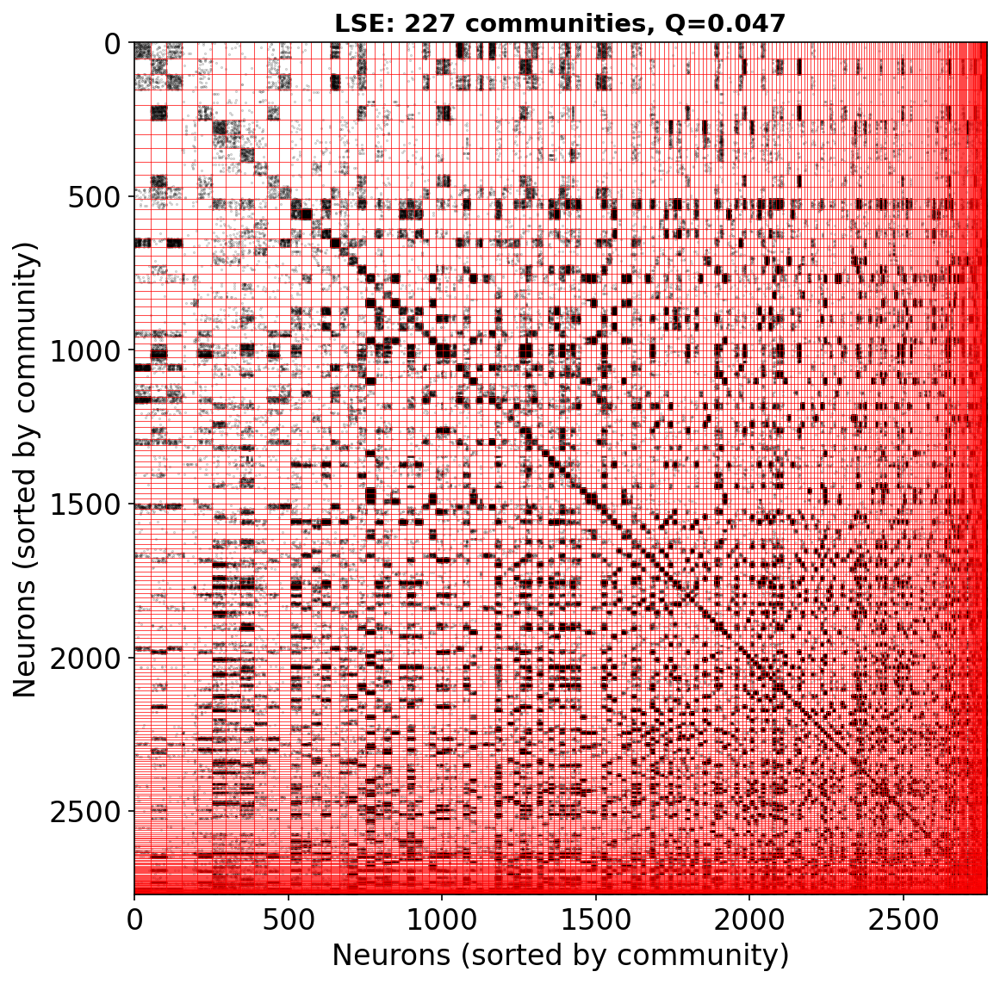

✓ Saved: imgs/fig_connectome_lse.png


In [38]:
# [FIGURE] LSE: Adjacency matrix sorted by community
if GRASPOLOGIC_AVAILABLE and 'lse_comms' in dir():
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    # Sort nodes by community (largest communities first)
    sorted_communities = sorted(enumerate(lse_comms), key=lambda x: -len(x[1]))
    ordered_nodes = []
    for _, comm in sorted_communities:
        ordered_nodes.extend(sorted(list(comm)))

    # Create reordered adjacency matrix
    node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
    order = [node_idx_map[n] for n in ordered_nodes]
    A_reordered = A_connectome[np.ix_(order, order)]

    # Plot as sparse matrix
    rows, cols = np.nonzero(A_reordered)
    ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
    ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
    ax.set_ylim(len(ordered_nodes)-0.5, -0.5)

    # Add community boundaries
    cumsum = 0
    for i, (_, comm) in enumerate(sorted_communities):
        cumsum += len(comm)
        ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
        ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)

    ax.set_title(f'LSE: {len(lse_comms)} communities, Q={lse_Q:.3f}', fontsize=14, fontweight='bold')
    ax.set_xlabel('Neurons (sorted by community)')
    ax.set_ylabel('Neurons (sorted by community)')
    ax.set_aspect('equal')

    plt.tight_layout()
    plt.savefig('imgs/fig_connectome_lse.png', dpi=150, bbox_inches='tight')
    plt.show()
    print('✓ Saved: imgs/fig_connectome_lse.png')
else:
    print('⚠️ LSE skipped (graspologic not available)')

---
# PART 5: COMPARING ALL METHODS

Now let's compare the results from all methods we've run.

## 5.1 Results Summary

All methods have been run. Let's compare their performance.

In [39]:
# ═══════════════════════════════════════════════════════════════════════════════
# Display results summary
# ═══════════════════════════════════════════════════════════════════════════════
print('COMMUNITY DETECTION RESULTS: FAFB Central Complex Connectome')
print(f'({G_connectome.number_of_nodes():,} neurons, {G_connectome.number_of_edges():,} connections)')
print('=' * 75)
print(results_df.to_string(index=False))
print('=' * 75)

# Highlight best method by modularity
best_idx = results_df['Modularity'].idxmax()
best_method = results_df.loc[best_idx, 'Method']
best_Q = results_df.loc[best_idx, 'Modularity']
print(f'\n💡 Highest modularity: {best_method} (Q = {best_Q:.3f})')

COMMUNITY DETECTION RESULTS: FAFB Central Complex Connectome
(2,772 neurons, 262,544 connections)
       Method  Communities  Modularity  Largest  Smallest      Time
      Louvain            9    0.553525      753         1  1.130480
       Leiden            9    0.551451      699         1  0.285206
          SBM          223    0.078475       72         2 46.851292
          SBM          118    0.102542       98         1 15.300305
       DC-SBM          122    0.123339       85         2 13.315907
Nested DC-SBM          301    0.073972       34         1 49.140548
          ASE            9    0.143545     2267         1  0.736156
          ASE          100    0.105298     1022         1  1.195644
          ASE          227    0.068799      693         1  1.260152
          LSE          227    0.047414       53         1  2.075684

💡 Highest modularity: Louvain (Q = 0.554)


Generating community comparison visualizations...


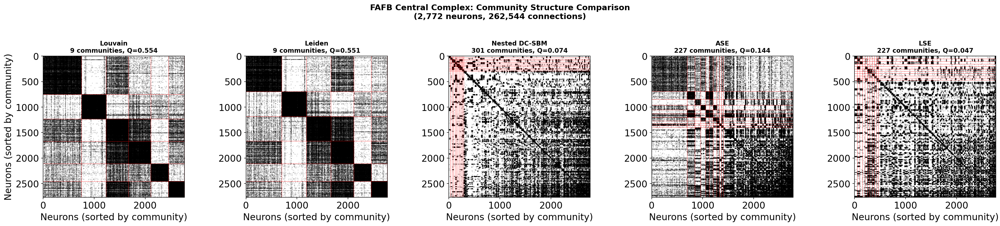

✓ Saved: imgs/fig_connectome_communities_comparison.png


In [45]:
# [FIGURE] Visualize connectome communities - Adjacency Matrix Comparison
print('Generating community comparison visualizations...')

# Collect all community results (only non-degenerate ones)
all_communities = {
    'Louvain': louvain_comms,
}

if GRASPOLOGIC_AVAILABLE and leiden_comms is not None:
    all_communities['Leiden'] = leiden_comms
if GRAPH_TOOL_AVAILABLE and 'sbm_results' in dir():
    all_communities['Nested DC-SBM'] = sbm_results['Nested DC-SBM']['comms']
if GRASPOLOGIC_AVAILABLE and 'ase_comms' in dir():
    all_communities['ASE'] = ase_comms
if GRASPOLOGIC_AVAILABLE and 'lse_comms' in dir():
    all_communities['LSE'] = lse_comms

n_methods = len(all_communities)
fig, axes = plt.subplots(1, n_methods, figsize=(5*n_methods, 5))
if n_methods == 1:
    axes = [axes]

for idx, (method, comms) in enumerate(all_communities.items()):
    ax = axes[idx]
    
    # Get modularity - handle nested DC-SBM specially
    if method == 'Nested DC-SBM':
        Q = sbm_results['Nested DC-SBM']['Q']
    else:
        Q_row = results_df[results_df['Method'] == method]['Modularity']
        Q = Q_row.values[0] if len(Q_row) > 0 else np.nan
    
    # Sort nodes by community
    sorted_communities = sorted(enumerate(comms), key=lambda x: -len(x[1]))
    ordered_nodes = []
    for _, comm in sorted_communities:
        ordered_nodes.extend(sorted(list(comm)))
    
    # Create reordered adjacency matrix
    node_idx_map = {n: i for i, n in enumerate(connectome_nodes)}
    order = [node_idx_map[n] for n in ordered_nodes]
    A_reordered = A_connectome[np.ix_(order, order)]
    
    # Plot as sparse matrix (only show nonzero entries)
    rows, cols = np.nonzero(A_reordered)
    ax.scatter(cols, rows, s=0.1, c='black', alpha=0.3)
    ax.set_xlim(-0.5, len(ordered_nodes)-0.5)
    ax.set_ylim(len(ordered_nodes)-0.5, -0.5)
    
    # Add community boundaries for top 10 communities
    cumsum = 0
    for i, (_, comm) in enumerate(sorted_communities[:10]):
        cumsum += len(comm)
        ax.axhline(y=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
        ax.axvline(x=cumsum-0.5, color='red', linewidth=0.5, alpha=0.7)
    
    Q_str = f'{Q:.3f}' if not np.isnan(Q) else 'N/A'
    ax.set_title(f'{method}\n{len(comms)} communities, Q={Q_str}', fontsize=11, fontweight='bold')
    ax.set_xlabel('Neurons (sorted by community)')
    if idx == 0:
        ax.set_ylabel('Neurons (sorted by community)')
    ax.set_aspect('equal')

plt.suptitle(f'FAFB Central Complex: Community Structure Comparison\n({G_connectome.number_of_nodes():,} neurons, {G_connectome.number_of_edges():,} connections)',
             fontsize=14, fontweight='bold', y=1.05)
plt.tight_layout()
plt.savefig('imgs/fig_connectome_communities_comparison.png', dpi=150, bbox_inches='tight')
plt.show()
print('✓ Saved: imgs/fig_connectome_communities_comparison.png')

In [46]:
# Interactive visualization using ipysigma
# Available community labels: community_louvain, community_leiden, community_sbm, community_ase, community_lse
# Color by Louvain community, size by degree
if IPYSIGMA_AVAILABLE:
    print('Interactive graph visualization (ipysigma)')
    print('Color: Louvain community | Size: node degree')
    print('Click the play button to start ForceAtlas2 layout algorithm')
    display(visualize_graph(G_connectome, 
                           node_color_attr='community_lse',
                           node_size_attr='degree',
                           height=700))
else:
    print('⚠️ ipysigma not available for interactive visualization')
    print('   Install with: pip install ipysigma')

Interactive graph visualization (ipysigma)
Color: Louvain community | Size: node degree
Click the play button to start ForceAtlas2 layout algorithm


Sigma(nx.DiGraph with 2,772 nodes and 262,544 edges)

In [47]:
# Interactive adjacency matrix visualization using Plotly
# Sorted by Louvain community
print('Interactive adjacency matrix (Plotly)')
print('Sorted by Louvain community membership')

plot_adjacency_matrix(G_connectome, 
                     sort_by='community',
                     community_attr='community_lse',
                     size=700,
                     marker_size=1).show()

Interactive adjacency matrix (Plotly)
Sorted by Louvain community membership


# PART 6: SUMMARY

## Method Comparison

| Method | Pros | Cons |
|--------|------|------|
| **Louvain/Leiden** | Fast, intuitive Q score | ! Assortative only |
| **Nested SBM** | Principled, hierarchical, auto k | Slower, requires graph-tool |
| **ASE/LSE** | Flexible, interpretable embedding | Requires choosing d and k |

## Best Practices

1. **Run multiple methods** and compare results
2. **Report hyperparameters** (resolution, n_components, etc.)
3. **Validate against metadata** when available (cell type, neurotransmitter)